In [117]:
import pandas as pd
from datetime import datetime
import ta
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

In [118]:
data = pd.read_csv(r'C:\Users\pc\Desktop\Python\NIFTY50.csv')
MAX_SHORT_SL_POINTS = 6
MAX_LONG_SL_POINTS = 12
data.head()


,symbol,datetime,open,high,low,close,volume
0,NIFTY50,7/17/2017 9:15,9908.15,9908.50,9900.50,9900.50,0
1,NIFTY50,7/17/2017 9:16,9901.90,9905.85,9899.50,9904.35,0
2,NIFTY50,7/17/2017 9:17,9904.45,9906.80,9903.30,9903.30,0
3,NIFTY50,7/17/2017 9:18,9903.35,9908.90,9903.35,9907.80,0
4,NIFTY50,7/17/2017 9:19,9907.00,9911.60,9905.35,9910.15,0


In [119]:
data = data[["datetime", "open", "high", "low", "close"]]



In [120]:
data.rename(columns={"datetime": "date"}, inplace=True)
data.head()


,date,open,high,low,close
0,7/17/2017 9:15,9908.15,9908.50,9900.50,9900.50
1,7/17/2017 9:16,9901.90,9905.85,9899.50,9904.35
2,7/17/2017 9:17,9904.45,9906.80,9903.30,9903.30
3,7/17/2017 9:18,9903.35,9908.90,9903.35,9907.80
4,7/17/2017 9:19,9907.00,9911.60,9905.35,9910.15


In [121]:
data["Date"] = data["date"].str.split(" ").str[0]
data["Time"] = data["date"].str.split(" ").str[1].str.split("+").str[0]
data["Date_Time"] = data['Date'] + " " + data["Time"]
data.drop("Date", axis = 1, inplace = True)
data


,date,open,high,low,close,Time,Date_Time
0,7/17/2017 9:15,9908.15,9908.50,9900.50,9900.50,9:15,7/17/2017 9:15
1,7/17/2017 9:16,9901.90,9905.85,9899.50,9904.35,9:16,7/17/2017 9:16
2,7/17/2017 9:17,9904.45,9906.80,9903.30,9903.30,9:17,7/17/2017 9:17
3,7/17/2017 9:18,9903.35,9908.90,9903.35,9907.80,9:18,7/17/2017 9:18
4,7/17/2017 9:19,9907.00,9911.60,9905.35,9910.15,9:19,7/17/2017 9:19
...,...,...,...,...,...,...,...
503018,12/20/2022 15:25,18387.65,18390.10,18387.65,18389.90,15:25,12/20/2022 15:25
503019,12/20/2022 15:26,18389.40,18392.10,18388.90,18391.85,15:26,12/20/2022 15:26
503020,12/20/2022 15:27,18392.10,18393.55,18389.65,18392.70,15:27,12/20/2022 15:27
503021,12/20/2022 15:28,18392.65,18393.15,18387.55,18387.55,15:28,12/20/2022 15:28


In [122]:
data['date'] = pd.to_datetime(data['date'], format='%m/%d/%Y %H:%M')
data['Date_Time'] = pd.to_datetime(data['Date_Time'], format='%m/%d/%Y %H:%M')
data['date'] = data['date'].dt.strftime('%Y-%m-%d %H:%M:%S')
data['Date_Time'] = data['Date_Time'].dt.strftime('%d-%m-%Y %H:%M')
data.head()

,date,open,high,low,close,Time,Date_Time
0,2017-07-17 09:15:00,9908.15,9908.50,9900.50,9900.50,9:15,17-07-2017 09:15
1,2017-07-17 09:16:00,9901.90,9905.85,9899.50,9904.35,9:16,17-07-2017 09:16
2,2017-07-17 09:17:00,9904.45,9906.80,9903.30,9903.30,9:17,17-07-2017 09:17
3,2017-07-17 09:18:00,9903.35,9908.90,9903.35,9907.80,9:18,17-07-2017 09:18
4,2017-07-17 09:19:00,9907.00,9911.60,9905.35,9910.15,9:19,17-07-2017 09:19


In [123]:
data['date'] = pd.to_datetime(data['date'])
data['date'] = data['date'] - pd.DateOffset(hours=5, minutes=30)
data['date'] = pd.to_datetime(data['date']).dt.strftime('%Y-%m-%d %H:%M:%S+05:30')
data.head()

,date,open,high,low,close,Time,Date_Time
0,2017-07-17 03:45:00+05:30,9908.15,9908.50,9900.50,9900.50,9:15,17-07-2017 09:15
1,2017-07-17 03:46:00+05:30,9901.90,9905.85,9899.50,9904.35,9:16,17-07-2017 09:16
2,2017-07-17 03:47:00+05:30,9904.45,9906.80,9903.30,9903.30,9:17,17-07-2017 09:17
3,2017-07-17 03:48:00+05:30,9903.35,9908.90,9903.35,9907.80,9:18,17-07-2017 09:18
4,2017-07-17 03:49:00+05:30,9907.00,9911.60,9905.35,9910.15,9:19,17-07-2017 09:19


In [124]:
data['Date_Time'] = pd.to_datetime(data['Date_Time'], format='%d-%m-%Y %H:%M')

# Set 'Date_Time' column as index
data.index = data['Date_Time']

# Drop 'date' column
data.drop(["date"], axis=1, inplace=True)

# Create 'Next Date_Time' column
data["Next Date_Time"] = data["Date_Time"].shift(-1)

In [125]:
data.head()

,open,high,low,close,Time,Date_Time,Next Date_Time
Date_Time,,,,,,,
2017-07-17 09:15:00,9908.15,9908.50,9900.50,9900.50,9:15,2017-07-17 09:15:00,2017-07-17 09:16:00
2017-07-17 09:16:00,9901.90,9905.85,9899.50,9904.35,9:16,2017-07-17 09:16:00,2017-07-17 09:17:00
2017-07-17 09:17:00,9904.45,9906.80,9903.30,9903.30,9:17,2017-07-17 09:17:00,2017-07-17 09:18:00
2017-07-17 09:18:00,9903.35,9908.90,9903.35,9907.80,9:18,2017-07-17 09:18:00,2017-07-17 09:19:00
2017-07-17 09:19:00,9907.00,9911.60,9905.35,9910.15,9:19,2017-07-17 09:19:00,2017-07-17 09:20:00


In [126]:
def convert_timeframe(data, tf):
    data = data.copy() #  To avoid modifying the original DataFrame

    new_data = {
    "Date_Time" : [],
    "Open" : [],
    "High" : [],
    "Low" : [],
    "Close" : []
    }

    step = 0

    for i in data.index:


        step += 1
        if step == 1:
            o = data.loc[i, "open"] 
            t = i
            h = data.loc[i, "high"] 
            l = data.loc[i, "low"]

        else:
            if data.loc[i, "high"]>h:
                h = data.loc[i, "high"]

            if data.loc[i, "low"] < l:
                l = data.loc[i, "low"]

        if step == tf or i.day!= data.loc[i, "Next Date_Time"].day: 
            step = 0
            c = data.loc[i, "close"]
            new_data["Date_Time"].append(t)
            new_data["Open"].append(o) 
            new_data["High"].append(h)
            new_data["Low"].append(l) 
            new_data["Close"].append(c)
    return pd.DataFrame(new_data)

data15 = convert_timeframe(data, 15)

data5 = convert_timeframe(data, 5)

data5_original = data5.copy()

data15_original = data15.copy()

data15.head()

,Date_Time,Open,High,Low,Close
0,2017-07-17 09:15:00,9908.15,9913.90,9899.50,9911.65
1,2017-07-17 09:30:00,9911.95,9915.15,9894.85,9897.70
2,2017-07-17 09:45:00,9899.05,9916.25,9898.45,9915.35
3,2017-07-17 10:00:00,9915.10,9916.70,9907.15,9915.30
4,2017-07-17 10:15:00,9915.45,9920.30,9911.80,9916.05


In [127]:
data5

,Date_Time,Open,High,Low,Close
0,2017-07-17 09:15:00,9908.15,9911.60,9899.50,9910.15
1,2017-07-17 09:20:00,9910.20,9910.20,9901.45,9907.65
2,2017-07-17 09:25:00,9907.45,9913.90,9906.05,9911.65
3,2017-07-17 09:30:00,9911.95,9915.15,9907.20,9909.00
4,2017-07-17 09:35:00,9908.95,9909.00,9898.75,9903.75
...,...,...,...,...,...
100665,2022-12-20 15:05:00,18369.25,18390.90,18369.25,18390.65
100666,2022-12-20 15:10:00,18391.00,18404.90,18390.90,18399.60
100667,2022-12-20 15:15:00,18399.50,18401.75,18381.55,18386.15
100668,2022-12-20 15:20:00,18386.15,18394.85,18383.55,18388.25


In [128]:
status = None
alert_candle = None
position = None
short_at = None
stop_loss = None

data5 = data5_original.copy()
data5["5EMA"] = ta.trend.EMAIndicator(data5["Close"], 5).ema_indicator()
day = None

for i in data5.index:
    if position is None:
        if alert_candle is None:  # Previous Candle is not an alert candle
            if data5.loc[i, "5EMA"] < data5.loc[i, "Low"]:  # Alert Candle
                alert_candle = i
                data5.loc[i, "ALERT"] = "ALERT"
        else:  # Previous Candle is an alert candle -> Try to take position
            if data5.loc[i, "Low"] < data5.loc[alert_candle, "Low"]:
                position = "SHORT"
                data5.loc[i, "POSITION"] = "ENTRY"
                if data5.loc[i, "Date_Time"].day != day:
                    data5.loc[i, "Days fund required"] = 1
                    day = data5.loc[i, "Date_Time"].day
                short_at = data5.loc[alert_candle, "Low"]
                stop_loss = min(data5.loc[alert_candle, "High"], short_at + MAX_SHORT_SL_POINTS)
                original_sl = stop_loss
                target = short_at - 3 * (stop_loss - short_at)
                data5.loc[i, "TARGET"] = target
                data5.loc[i, "SL"] = stop_loss
                data5.loc[i, "ENTRY_AT"] = short_at
                alert_candle = None
            elif data5.loc[i, "5EMA"] < data5.loc[i, "Low"]:  # Check for once again alert
                alert_candle = i
                data5.loc[i, "ALERT"] = "ALERT"
            else:
                alert_candle = None
    else:
        data5.loc[i, "POSITION"] = "HOLD"
        data5.loc[i, "SL"] = stop_loss
        data5.loc[i, "TARGET"] = target
        data5.loc[i, "ENTRY_AT"] = short_at
        
        if data5.loc[i, "Low"] <= target:
            data5.loc[i, "POSITION"] = "TRAIL"
            temp = target - (original_sl - short_at)
            stop_loss = target
            target = temp
            data5.loc[i, "SL"] = stop_loss
            data5.loc[i, "TARGET"] = target
        elif data5.loc[i, "High"] >= stop_loss:
            data5.loc[i, "POSITION"] = "EXIT"
            position = None
            profit = short_at - stop_loss
            data5.loc[i, "PROFIT"] = profit
            data5.loc[i, "EXIT_AT"] = stop_loss




In [129]:
data5.iloc[4223:4257]

,Date_Time,Open,High,Low,Close,5EMA,ALERT,POSITION,Days fund required,TARGET,SL,ENTRY_AT,PROFIT,EXIT_AT
4223,2017-10-05 12:59:00,9902.75,9903.00,9898.75,9900.60,9901.319887,NaN,HOLD,NaN,9891.00,9906.80,9902.85,NaN,NaN
4224,2017-10-05 13:04:00,9900.60,9906.95,9900.45,9904.85,9902.496591,NaN,EXIT,NaN,9891.00,9906.80,9902.85,-3.95,9906.80
4225,2017-10-05 13:09:00,9904.65,9908.25,9902.55,9907.95,9904.314394,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4226,2017-10-05 13:14:00,9908.15,9908.35,9904.75,9906.25,9904.959596,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4227,2017-10-05 13:19:00,9906.25,9906.55,9903.30,9904.05,9904.656397,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4228,2017-10-05 13:24:00,9904.05,9904.35,9897.85,9899.40,9902.904265,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4229,2017-10-05 13:29:00,9899.45,9901.60,9898.05,9900.65,9902.152843,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4230,2017-10-05 13:34:00,9900.75,9905.30,9900.75,9904.95,9903.085229,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4231,2017-10-05 13:39:00,9904.70,9911.65,9903.05,9910.00,9905.390153,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4232,2017-10-05 13:44:00,9910.10,9920.45,9910.10,9917.90,9909.560102,ALERT,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [130]:
data5.index=data5["Date_Time"] 

In [131]:
data5["PROFIT"].resample("A").sum()

C:\Users\pc\AppData\Local\Temp\ipykernel_8172\4040009994.py:1: FutureWarning: 'A' is deprecated and will be removed in a future version, please use 'YE' instead.
  data5["PROFIT"].resample("A").sum()


Date_Time
2017-12-31     1963.50
2018-12-31     4458.80
2019-12-31     6447.35
2020-12-31     8686.00
2021-12-31    10740.90
2022-12-31    13986.70
Freq: YE-DEC, Name: PROFIT, dtype: float64

In [132]:
status = None
alert_candle = None
position = None
long_at = None
stop_loss = None

data15 = data15_original.copy()
data15["5EMA"] = ta.trend.EMAIndicator(data15["Close"], 5).ema_indicator()
day = None

for i in data15.index:
    if position is None:
        if alert_candle is None:  # Previous Candle is not an alert candle
            if data15.loc[i, "5EMA"] > data15.loc[i, "High"]:  # Alert Candle
                alert_candle = i
                data15.loc[i, "ALERT"] = "ALERT"
        else:  # Previous Candle is an alert candle -> Try to take position
            if data15.loc[i, "High"] > data15.loc[alert_candle, "High"]:
                position = "LONG"
                data15.loc[i, "POSITION"] = "ENTRY"
                if data15.loc[i, "Date_Time"].day != day:
                    data15.loc[i, "Days fund required"] = 1
                    day = data15.loc[i, "Date_Time"].day
                long_at = data15.loc[alert_candle, "High"]
                stop_loss = max(data15.loc[alert_candle, "Low"], long_at - MAX_LONG_SL_POINTS)
                original_sl = stop_loss
                target = long_at + 3 * (long_at - stop_loss)
                data15.loc[i, "TARGET"] = target
                data15.loc[i, "SL"] = stop_loss
                data15.loc[i, "ENTRY_AT"] = long_at
                alert_candle = None
            elif data15.loc[i, "5EMA"] > data15.loc[i, "High"]:  # Check for once again alert
                alert_candle = i
                data15.loc[i, "ALERT"] = "ALERT"
            else:
                alert_candle = None
    else:  # I already have a position
        data15.loc[i, "POSITION"] = "HOLD"
        data15.loc[i, "SL"] = stop_loss
        data15.loc[i, "TARGET"] = target
        data15.loc[i, "ENTRY_AT"] = long_at
        
        if data15.loc[i, "High"] >= target:
            data15.loc[i, "POSITION"] = "TRAIL"
            temp = target + (long_at - original_sl)
            stop_loss = target
            target = temp
            data15.loc[i, "SL"] = stop_loss
            data15.loc[i, "TARGET"] = target
        elif data15.loc[i, "Low"] <= stop_loss:
            data15.loc[i, "POSITION"] = "EXIT"
            position = None
            profit = stop_loss - long_at
            data15.loc[i, "PROFIT"] = profit
            data15.loc[i, "EXIT_AT"] = stop_loss

data15.loc[4353:4373]
data15.head()

,Date_Time,Open,High,Low,Close,5EMA,ALERT,POSITION,Days fund required,TARGET,SL,ENTRY_AT,PROFIT,EXIT_AT
0,2017-07-17 09:15:00,9908.15,9913.90,9899.50,9911.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2017-07-17 09:30:00,9911.95,9915.15,9894.85,9897.70,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2017-07-17 09:45:00,9899.05,9916.25,9898.45,9915.35,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2017-07-17 10:00:00,9915.10,9916.70,9907.15,9915.30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2017-07-17 10:15:00,9915.45,9920.30,9911.80,9916.05,9913.098148,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [133]:
data15.index = data15["Date_Time"]
data15["PROFIT"].resample("A").sum()


C:\Users\pc\AppData\Local\Temp\ipykernel_8172\719799760.py:2: FutureWarning: 'A' is deprecated and will be removed in a future version, please use 'YE' instead.
  data15["PROFIT"].resample("A").sum()


Date_Time
2017-12-31    1491.00
2018-12-31    2329.95
2019-12-31    2467.00
2020-12-31    4927.65
2021-12-31    6574.65
2022-12-31    9046.65
Freq: YE-DEC, Name: PROFIT, dtype: float64

In [134]:
test_data5 = data5[["Date_Time", "POSITION", "PROFIT"]]
test_data15 = data15[["Date_Time", "POSITION", "PROFIT"]]

data15i = 0
data5i = 0
position = None
final_data = {
    "Entry_Date_Time": [],
    "Position": [],
    "Exit_Date_Time": [],
    "Profit": []
}

def calculate_profit(i5, i15):
    global position, final_data, test_data15, test_data5

    if position is None:
        if test_data15.iloc[i15, 1] == "ENTRY":
            position = "LONG"
            final_data["Entry_Date_Time"].append(test_data15.iloc[i15, 0])
            final_data["Position"].append("Long")
        elif test_data5.iloc[i5, 1] == "ENTRY":
            position = "SHORT"
            final_data["Entry_Date_Time"].append(test_data5.iloc[i5, 0])
            final_data["Position"].append("Short")
    elif position == "LONG":
        if test_data15.iloc[i15, 1] == "EXIT":
            final_data["Exit_Date_Time"].append(test_data15.iloc[i15, 0])
            final_data["Profit"].append(test_data15.iloc[i15, 2])
            position = None
    elif position == "SHORT":
        if test_data5.iloc[i5, 1] == "EXIT":
            final_data["Exit_Date_Time"].append(test_data5.iloc[i5, 0])
            final_data["Profit"].append(test_data5.iloc[i5, 2])
            position = None

while True:
    if data15i == len(test_data15):
        break
    if test_data15.iloc[data15i, 0] > test_data5.iloc[data5i, 0]:
        calculate_profit(data5i, data15i)
        data5i += 1
    else:
        calculate_profit(data5i, data15i)
        data15i += 1

final_data["Exit_Date_Time"].append(None)
final_data["Profit"].append(None)
final_data = pd.DataFrame(final_data)

final_data


,Entry_Date_Time,Position,Exit_Date_Time,Profit
0,2017-07-17 10:00:00,Short,2017-07-17 10:10:00,-4.00
1,2017-07-17 11:45:00,Long,2017-07-17 12:15:00,-8.50
2,2017-07-17 13:40:00,Short,2017-07-17 13:50:00,-3.35
3,2017-07-17 14:25:00,Short,2017-07-17 14:30:00,-3.40
4,2017-07-17 14:55:00,Short,2017-07-17 15:05:00,-6.00
...,...,...,...,...
7548,2022-12-20 13:50:00,Short,2022-12-20 14:00:00,-6.00
7549,2022-12-20 14:15:00,Short,2022-12-20 14:20:00,-6.00
7550,2022-12-20 14:30:00,Short,2022-12-20 14:35:00,-6.00
7551,2022-12-20 14:45:00,Short,2022-12-20 14:55:00,-6.00


<Axes: >

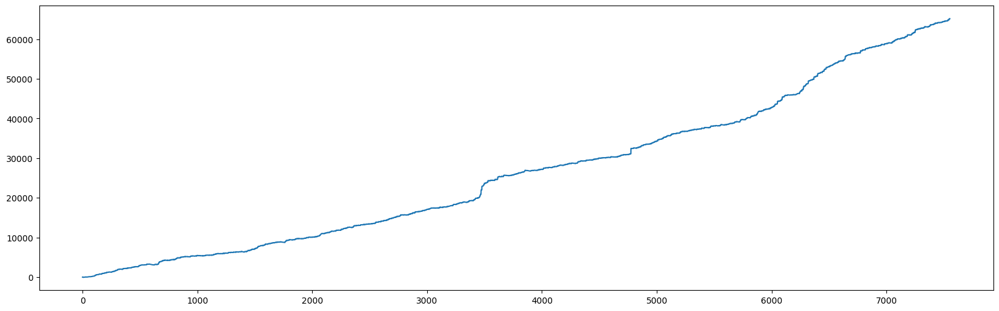

In [135]:
intraday_trade_log=pd.DataFrame(final_data)
import matplotlib.pyplot as plt
plt.figure(figsize=(20,6))
intraday_trade_log['Profit'].cumsum().plot()


<Axes: >

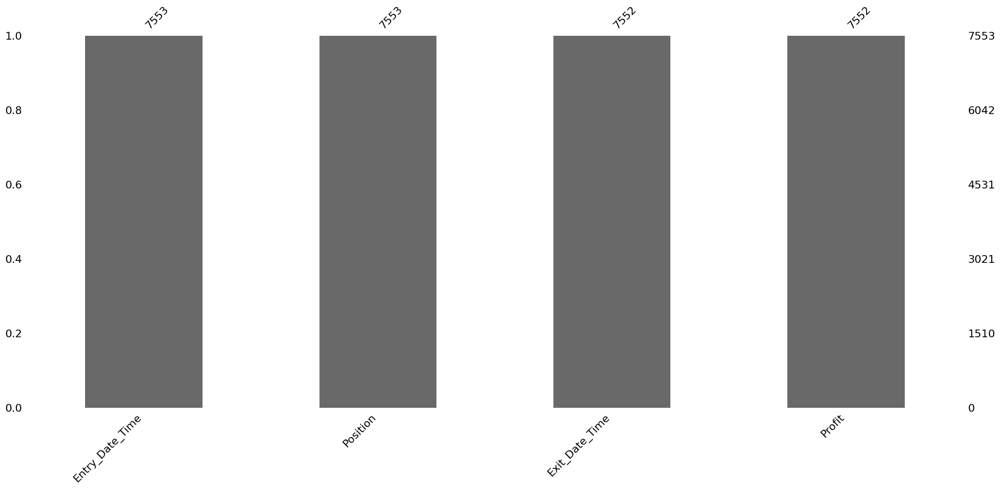

In [136]:
import missingno as msno
msno.bar(intraday_trade_log)


<class 'pandas.core.frame.DataFrame'>
Index: 7552 entries, 0 to 7551
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   Entry_Date_Time  7552 non-null   datetime64[ns]
 1   Position         7552 non-null   object        
 2   Exit_Date_Time   7552 non-null   datetime64[ns]
 3   Profit           7552 non-null   float64       
dtypes: datetime64[ns](2), float64(1), object(1)
memory usage: 295.0+ KB


<Axes: >

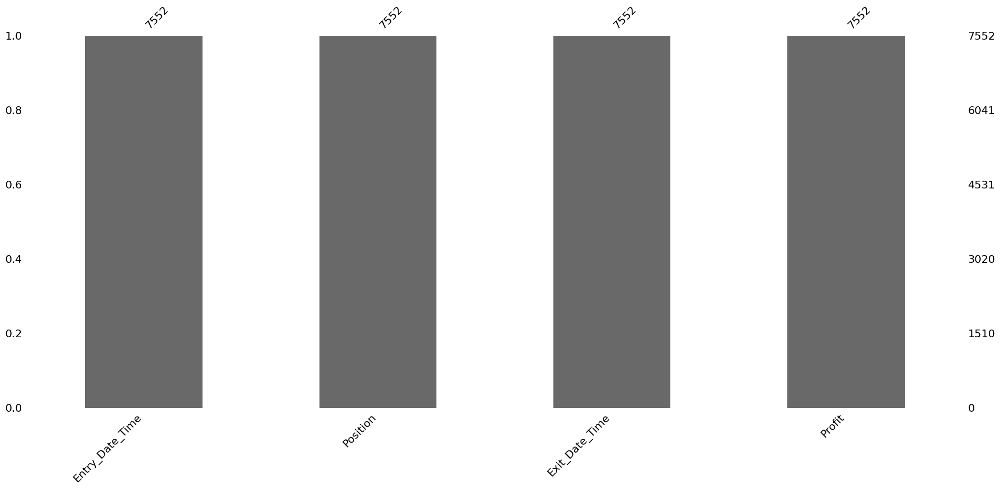

In [137]:
intraday_trade_log=intraday_trade_log[intraday_trade_log['Entry_Date_Time'].notna()]
intraday_trade_log=intraday_trade_log[intraday_trade_log['Position'].notna()]
intraday_trade_log=intraday_trade_log[intraday_trade_log['Exit_Date_Time'].notna()]
intraday_trade_log=intraday_trade_log[intraday_trade_log['Profit'].notna()]
intraday_trade_log.info()
msno.bar(intraday_trade_log)

In [138]:
insample_trade_log = intraday_trade_log[:int(len(intraday_trade_log)/2)]
outsample_trade_log = intraday_trade_log[int(len(intraday_trade_log)/2):]
insample_trade_log
outsample_trade_log


,Entry_Date_Time,Position,Exit_Date_Time,Profit
3776,2020-06-11 10:15:00,Short,2020-06-11 11:25:00,72.0
3777,2020-06-11 11:30:00,Long,2020-06-11 11:45:00,-12.0
3778,2020-06-11 11:55:00,Short,2020-06-11 12:05:00,18.0
3779,2020-06-11 13:45:00,Long,2020-06-11 14:00:00,-12.0
3780,2020-06-12 09:30:00,Long,2020-06-12 09:45:00,-12.0
...,...,...,...,...
7547,2022-12-20 13:10:00,Short,2022-12-20 13:20:00,18.0
7548,2022-12-20 13:50:00,Short,2022-12-20 14:00:00,-6.0
7549,2022-12-20 14:15:00,Short,2022-12-20 14:20:00,-6.0
7550,2022-12-20 14:30:00,Short,2022-12-20 14:35:00,-6.0


In [139]:
initial_capital=200000
intraday_trade_log['Quantity']=50

In [140]:
intraday_trade_log['PnL_Including_Slippages'] = (intraday_trade_log['Profit'])*intraday_trade_log['Quantity']
intraday_trade_log

,Entry_Date_Time,Position,Exit_Date_Time,Profit,Quantity,PnL_Including_Slippages
0,2017-07-17 10:00:00,Short,2017-07-17 10:10:00,-4.00,50,-200.0
1,2017-07-17 11:45:00,Long,2017-07-17 12:15:00,-8.50,50,-425.0
2,2017-07-17 13:40:00,Short,2017-07-17 13:50:00,-3.35,50,-167.5
3,2017-07-17 14:25:00,Short,2017-07-17 14:30:00,-3.40,50,-170.0
4,2017-07-17 14:55:00,Short,2017-07-17 15:05:00,-6.00,50,-300.0
...,...,...,...,...,...,...
7547,2022-12-20 13:10:00,Short,2022-12-20 13:20:00,18.00,50,900.0
7548,2022-12-20 13:50:00,Short,2022-12-20 14:00:00,-6.00,50,-300.0
7549,2022-12-20 14:15:00,Short,2022-12-20 14:20:00,-6.00,50,-300.0
7550,2022-12-20 14:30:00,Short,2022-12-20 14:35:00,-6.00,50,-300.0


In [141]:
intraday_trade_log['PnL_Including_Slippages_Cumulative_Sum'] = intraday_trade_log['PnL_Including_Slippages'].cumsum()
intraday_trade_log

,Entry_Date_Time,Position,Exit_Date_Time,Profit,Quantity,PnL_Including_Slippages,PnL_Including_Slippages_Cumulative_Sum
0,2017-07-17 10:00:00,Short,2017-07-17 10:10:00,-4.00,50,-200.0,-200.0
1,2017-07-17 11:45:00,Long,2017-07-17 12:15:00,-8.50,50,-425.0,-625.0
2,2017-07-17 13:40:00,Short,2017-07-17 13:50:00,-3.35,50,-167.5,-792.5
3,2017-07-17 14:25:00,Short,2017-07-17 14:30:00,-3.40,50,-170.0,-962.5
4,2017-07-17 14:55:00,Short,2017-07-17 15:05:00,-6.00,50,-300.0,-1262.5
...,...,...,...,...,...,...,...
7547,2022-12-20 13:10:00,Short,2022-12-20 13:20:00,18.00,50,900.0,3258305.0
7548,2022-12-20 13:50:00,Short,2022-12-20 14:00:00,-6.00,50,-300.0,3258005.0
7549,2022-12-20 14:15:00,Short,2022-12-20 14:20:00,-6.00,50,-300.0,3257705.0
7550,2022-12-20 14:30:00,Short,2022-12-20 14:35:00,-6.00,50,-300.0,3257405.0


In [142]:
intraday_trade_log['Equity'] = 0
intraday_trade_log['Rate_of_Return'] = 0

In [143]:
for i in range(len(list(intraday_trade_log.index))):

    if i == 0:
        intraday_trade_log['Equity'].iloc[i] = initial_capital + intraday_trade_log['PnL_Including_Slippages'].iloc[i]
        intraday_trade_log['Rate_of_Return'].iloc[i] = (intraday_trade_log['PnL_Including_Slippages'].iloc[i]/initial_capital)*100
    else:
        intraday_trade_log['Equity'].iloc[i] = intraday_trade_log['Equity'].iloc[i-1] + intraday_trade_log['PnL_Including_Slippages'].iloc[i]
        intraday_trade_log['Rate_of_Return'].iloc[i] = (intraday_trade_log['PnL_Including_Slippages'].iloc[i]/intraday_trade_log['Equity'].iloc[i-1])*100

C:\Users\pc\AppData\Local\Temp\ipykernel_8172\138033945.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  intraday_trade_log['Equity'].iloc[i] = initial_capital + intraday_trade_log['PnL_Including_Slippages'].iloc[i]
C:\Users\pc\AppData\Lo

In [144]:
win_rate = round(len(intraday_trade_log[intraday_trade_log['PnL_Including_Slippages']>0])/len(intraday_trade_log),2)
print(f'Win Rate:{win_rate}')

Win Rate:0.33


In [145]:
mean_win = intraday_trade_log[intraday_trade_log['PnL_Including_Slippages']>0]['PnL_Including_Slippages'].mean()
mean_loss = intraday_trade_log[intraday_trade_log['PnL_Including_Slippages']<0]['PnL_Including_Slippages'].mean()
risk_reward = abs(mean_win/mean_loss)
expectancy = round((win_rate*risk_reward) - ((1-win_rate)*1),2)

print(f'Expectancy:{expectancy}')

Expectancy:1.23


In [146]:
import numpy as np
number_of_trading_days_in_a_year = 252
risk_free_interest_rate = 5
mean = intraday_trade_log['Rate_of_Return'].mean() * number_of_trading_days_in_a_year - risk_free_interest_rate
sigma = intraday_trade_log['Rate_of_Return'].std() * np.sqrt(number_of_trading_days_in_a_year)
sharpe_ratio = round(mean/sigma,2)

print(f'Sharpe Ratio:{sharpe_ratio}')

Sharpe Ratio:1.55


In [147]:
downside_standard_deviation = intraday_trade_log[intraday_trade_log['Rate_of_Return']<0]['Rate_of_Return'].std() * np.sqrt(number_of_trading_days_in_a_year)
sortino_ratio = round(mean/downside_standard_deviation,2)
print(f'Sortino Ratio:{sortino_ratio}')

Sortino Ratio:8.43


In [148]:
intraday_trade_log['Drawdown'] = intraday_trade_log['PnL_Including_Slippages_Cumulative_Sum'] - intraday_trade_log['PnL_Including_Slippages_Cumulative_Sum'].cummax()
max_drawdown = round(intraday_trade_log['Drawdown'].min(),2)
print(f'Max Drawdown [Rs.] :{max_drawdown}')

max_drawdown_percent = round(max_drawdown/intraday_trade_log[intraday_trade_log['Drawdown'] == intraday_trade_log['Drawdown'].min()]['Equity'].iloc[0]*100,2)
print(f'Max Drawdown Percent:{max_drawdown_percent}')

Max Drawdown [Rs.] :-12225.0
Max Drawdown Percent:-3.46


In [149]:
intraday_trade_log['Recovery'] = 0
for i in range(len(intraday_trade_log)):
    if (intraday_trade_log['Drawdown'].iloc[i] < 0):
        intraday_trade_log['Recovery'].iloc[i] = intraday_trade_log['Recovery'].iloc[i-1] + 1
recovery_trades = intraday_trade_log['Recovery'].max()
print(f'Number of trades done from Drawdown to achieve a new peak: {recovery_trades}')



C:\Users\pc\AppData\Local\Temp\ipykernel_8172\1759126011.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  intraday_trade_log['Recovery'].iloc[i] = intraday_trade_log['Recovery'].iloc[i-1] + 1
C:\Users\pc\AppData\Local\Temp\ipykernel_8172\

Number of trades done from Drawdown to achieve a new peak: 82


C:\Users\pc\AppData\Local\Temp\ipykernel_8172\1759126011.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  intraday_trade_log['Recovery'].iloc[i] = intraday_trade_log['Recovery'].iloc[i-1] + 1
C:\Users\pc\AppData\Local\Temp\ipykernel_8172\1759126011.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = val

In [150]:
recovery_trades = intraday_trade_log['Recovery'].max()
print(f'Number of trades done from Drawdown to achieve a new peak: {recovery_trades}')

Number of trades done from Drawdown to achieve a new peak: 82


In [151]:
print(intraday_trade_log.columns)


Index(['Entry_Date_Time', 'Position', 'Exit_Date_Time', 'Profit', 'Quantity',
       'PnL_Including_Slippages', 'PnL_Including_Slippages_Cumulative_Sum',
       'Equity', 'Rate_of_Return', 'Drawdown', 'Recovery'],
      dtype='object')


In [152]:
intraday_trade_log.head()

,Entry_Date_Time,Position,Exit_Date_Time,Profit,Quantity,PnL_Including_Slippages,PnL_Including_Slippages_Cumulative_Sum,Equity,Rate_of_Return,Drawdown,Recovery
0,2017-07-17 10:00:00,Short,2017-07-17 10:10:00,-4.00,50,-200.0,-200.0,199800.0,-0.100000,0.0,0
1,2017-07-17 11:45:00,Long,2017-07-17 12:15:00,-8.50,50,-425.0,-625.0,199375.0,-0.212713,-425.0,1
2,2017-07-17 13:40:00,Short,2017-07-17 13:50:00,-3.35,50,-167.5,-792.5,199207.5,-0.084013,-592.5,2
3,2017-07-17 14:25:00,Short,2017-07-17 14:30:00,-3.40,50,-170.0,-962.5,199037.5,-0.085338,-762.5,3
4,2017-07-17 14:55:00,Short,2017-07-17 15:05:00,-6.00,50,-300.0,-1262.5,198737.5,-0.150725,-1062.5,4


In [153]:
intraday_trade_log_equity_high = intraday_trade_log[intraday_trade_log['Recovery'] == 0]

intraday_trade_log_equity_high['Entry_Date_Time'] = pd.to_datetime(intraday_trade_log_equity_high['Entry_Date_Time'])

intraday_trade_log_equity_high['number_days_between_equity_highs'] = intraday_trade_log_equity_high['Entry_Date_Time'] - intraday_trade_log_equity_high['Entry_Date_Time'].shift()

recovery_days = intraday_trade_log_equity_high['number_days_between_equity_highs'].apply(lambda x: x.days).max()

print(f'Number of Days taken from Drawdown to achieve a new peak: {recovery_days}')

Number of Days taken from Drawdown to achieve a new peak: 24.0


C:\Users\pc\AppData\Local\Temp\ipykernel_8172\1347973414.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  intraday_trade_log_equity_high['Entry_Date_Time'] = pd.to_datetime(intraday_trade_log_equity_high['Entry_Date_Time'])
C:\Users\pc\AppData\Local\Temp\ipykernel_8172\1347973414.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  intraday_trade_log_equity_high['number_days_between_equity_highs'] = intraday_trade_log_equity_high['Entry_Date_Time'] - intraday_trade_log_equity_high['Entry_Date_Time'].shift

In [154]:

intraday_trade_log['Entry_Date_Time'] = pd.to_datetime(intraday_trade_log['Entry_Date_Time'])
number_of_trading_days_for_this_backtest = (intraday_trade_log.iloc[-1]['Entry_Date_Time'].date() - intraday_trade_log.iloc[0]['Entry_Date_Time'].date()).days
cagr = (((intraday_trade_log.iloc[-1]['Equity'] / initial_capital) ** (1 / (number_of_trading_days_for_this_backtest / 365))) - 1) * 100
cagr = round(cagr, 2)
print(f'CAGR: {cagr}%')


CAGR: 69.02%


In [155]:
calmar_ratio = round(abs(cagr/max_drawdown_percent),2)

print(f'Calmar Ratio:{calmar_ratio}')

Calmar Ratio:19.95


In [156]:
backtest_start_date = intraday_trade_log.iloc[0]['Entry_Date_Time'].date()
backtest_start_date
backtest_end_date = intraday_trade_log.iloc[-1]['Entry_Date_Time'].date()
backtest_end_date


datetime.date(2022, 12, 20)

In [157]:
number_of_trades = len(intraday_trade_log)
number_of_trades

7552

In [158]:
number_of_wins = len(intraday_trade_log[intraday_trade_log['PnL_Including_Slippages']>0])
print(f'Number of Wins: {number_of_wins}')

number_of_losses = len(intraday_trade_log[intraday_trade_log['PnL_Including_Slippages']<0])
print(f'Number of Losses: {number_of_losses}')

Number of Wins: 2483
Number of Losses: 5065


In [159]:
average_profit_per_trade = round(intraday_trade_log[intraday_trade_log['PnL_Including_Slippages'] > 0]['PnL_Including_Slippages'].mean(),2)
print(f'Average Profit Per Trade: {average_profit_per_trade}')

average_loss_per_trade = round(intraday_trade_log[intraday_trade_log['PnL_Including_Slippages'] < 0]['PnL_Including_Slippages'].mean(),2)
print(f'Average Loss Per Trade: {average_loss_per_trade}')

Average Profit Per Trade: 2032.24
Average Loss Per Trade: -353.2


In [160]:
max_pnl = round(intraday_trade_log['PnL_Including_Slippages'].max(),2)
print(f'Max PnL Point:{max_pnl}')

min_pnl = round(intraday_trade_log['PnL_Including_Slippages'].min(),2)
print(f'Min PnL Point:{min_pnl}')

Max PnL Point:64200.0
Min PnL Point:-600.0


In [161]:
median_of_trade = round(intraday_trade_log['PnL_Including_Slippages'].median(),2)
print(f'Median:{median_of_trade}')

Median:-300.0


In [162]:
gross_profit = intraday_trade_log[intraday_trade_log['PnL_Including_Slippages']>0]['PnL_Including_Slippages'].sum()
gross_loss = intraday_trade_log[intraday_trade_log['PnL_Including_Slippages']<0]['PnL_Including_Slippages'].sum()

profit_factor = round(abs(gross_profit/gross_loss),2)
print(f'Profit Factor:{profit_factor}')
# did't remove outlier profit factor

Profit Factor:2.82


In [163]:
outlier_adjusted_profit_factor = round(abs((gross_profit-max_pnl)/gross_loss),2)
print(f'Outlier Adjusted Profit Factor:{outlier_adjusted_profit_factor}')

Outlier Adjusted Profit Factor:2.78


In [164]:
intraday_trade_log['Continuous_Wins'] = 0
intraday_trade_log['Continuous_Losses'] = 0

In [165]:
for i in range(1,len(intraday_trade_log)):
    if intraday_trade_log['PnL_Including_Slippages'].iloc[i-1] > 0:
        intraday_trade_log['Continuous_Wins'].iloc[i] = intraday_trade_log['Continuous_Wins'].iloc[i-1]+1
    if intraday_trade_log['PnL_Including_Slippages'].iloc[i-1] < 0:
        intraday_trade_log['Continuous_Losses'].iloc[i] = intraday_trade_log['Continuous_Losses'].iloc[i-1]+1

C:\Users\pc\AppData\Local\Temp\ipykernel_8172\1117506453.py:5: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  intraday_trade_log['Continuous_Losses'].iloc[i] = intraday_trade_log['Continuous_Losses'].iloc[i-1]+1
C:\Users\pc\AppData\Local\Temp

In [166]:
consecutive_wins = intraday_trade_log['Continuous_Wins'].max()
consecutive_losses = intraday_trade_log['Continuous_Losses'].max()
print(f'Consecutive Wins:{consecutive_wins}')
print(f'Consecutive Losses:{consecutive_losses}')

Consecutive Wins:9
Consecutive Losses:34


In [167]:
metrics = pd.DataFrame(columns=['Backtest Start Date','Backtest End Date','Number of Trades','Number of Wins','Number of Losses','Average Profit','Average Loss','Maximum Profit Points','Maximum Loss Points','Median Trade','Win Rate','Expectancy','Sharpe Ratio','Sortino Ratio','Max Drawdown','Max Drawdown Percent','Days Taken to Recover From Drawdown','Number of Trades to Recover From Drawdown','Calmar','CAGR','Consecutive Wins','Consecutive Losses','Profit Factor (Amount of Profit per unit of Loss)','Outlier Adjusted Profit Factor (Profit Factor except that One Exceptional Biggest Winner)'])

In [168]:
import pandas as pd

metrics_data = []

metrics_dict = {
    'Backtest Start Date': backtest_start_date,
    'Backtest End Date': backtest_end_date,
    'Number of Trades': number_of_trades,
    'Number of Wins': number_of_wins,
    'Number of Losses': number_of_losses,
    'Average Profit': average_profit_per_trade,
    'Average Loss': average_loss_per_trade,
    'Maximum Profit Points': max_pnl,
    'Maximum Loss Points': min_pnl,
    'Median Trade': median_of_trade,
    'Win Rate': win_rate,
    'Expectancy': expectancy,
    'Sharpe Ratio': sharpe_ratio,
    'Sortino Ratio': sortino_ratio,
    'Max Drawdown': max_drawdown,
    'Max Drawdown Percent': max_drawdown_percent,
    'Days Taken to Recover From Drawdown': recovery_days,
    'Number of Trades to Recover From Drawdown': recovery_trades,
    'Calmar': calmar_ratio,
    'CAGR': cagr,
    'Consecutive Wins': consecutive_wins,
    'Consecutive Losses': consecutive_losses,
    'Profit Factor (Amount of Profit per unit of Loss)': profit_factor,
    'Outlier Adjusted Profit Factor (Profit Factor except that One Exceptional Biggest Winner)': outlier_adjusted_profit_factor
}

metrics_data.append(metrics_dict)

metrics = pd.DataFrame(metrics_data)


In [169]:
metrics.T

,0
Backtest Start Date,2017-07-17
Backtest End Date,2022-12-20
Number of Trades,7552
Number of Wins,2483
Number of Losses,5065
Average Profit,2032.24
Average Loss,-353.2
Maximum Profit Points,64200.0
Maximum Loss Points,-600.0
Median Trade,-300.0


In [170]:
returns = intraday_trade_log[['Entry_Date_Time','Equity']]
returns.set_index('Entry_Date_Time',inplace=True)
returns = returns.resample('M').last()
returns['%Change'] = returns['Equity'].pct_change()*100
returns.reset_index(inplace=True)
returns['Year'] = returns['Entry_Date_Time'].apply(lambda x: x.year)
returns['Month'] = returns['Entry_Date_Time'].apply(lambda x: x.month)
import calendar
returns['Month'] = returns['Month'].apply(lambda x: calendar.month_abbr[x])
returns = returns[['Entry_Date_Time', '%Change', 'Year', 'Month']]
x = returns.groupby(['Year','Month'])['%Change'].mean()
broad_returns = x.unstack()
broad_returns['Total'] = broad_returns[broad_returns.columns].sum(axis=1)
broad_returns = broad_returns[['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec', 'Total']]
broad_returns = round(broad_returns,2)
broad_returns

C:\Users\pc\AppData\Local\Temp\ipykernel_8172\3399612394.py:3: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  returns = returns.resample('M').last()


Month,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec,Total
Year,,,,,,,,,,,,,
2017,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20.28,9.62,13.38,7.50,7.54,58.33
2018,1.05,15.50,6.78,4.92,1.23,5.95,2.37,1.86,7.38,11.30,3.08,6.62,68.04
2019,2.99,6.53,4.07,4.12,5.47,2.57,5.09,7.05,1.61,4.44,2.45,2.43,48.83
2020,4.46,3.62,16.52,5.35,1.51,4.32,1.01,2.36,2.57,1.56,2.23,0.93,46.45
2021,2.47,4.71,3.98,4.57,1.69,1.59,1.81,1.52,3.46,3.64,3.32,5.40,38.16
2022,3.25,5.75,4.68,2.54,3.23,2.23,1.76,1.87,2.70,2.10,1.62,1.38,33.11


In [171]:
import seaborn as sns

# Create a colormap
cm = sns.light_palette('green', as_cmap=True)

# Apply background gradient and highlighting to the DataFrame
broad_returns_image = broad_returns.style.background_gradient(cmap=cm, axis=0)\
    .highlight_min(axis=0, color='lightgreen')\
    .highlight_max(axis=0, color='green')\
    .format('{:.2f}')

# You can display the styled DataFrame
broad_returns_image


Month,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec,Total
Year,,,,,,,,,,,,,
2017,nan,nan,nan,nan,nan,nan,nan,20.28,9.62,13.38,7.50,7.54,58.33
2018,1.05,15.50,6.78,4.92,1.23,5.95,2.37,1.86,7.38,11.30,3.08,6.62,68.04
2019,2.99,6.53,4.07,4.12,5.47,2.57,5.09,7.05,1.61,4.44,2.45,2.43,48.83
2020,4.46,3.62,16.52,5.35,1.51,4.32,1.01,2.36,2.57,1.56,2.23,0.93,46.45
2021,2.47,4.71,3.98,4.57,1.69,1.59,1.81,1.52,3.46,3.64,3.32,5.40,38.16
2022,3.25,5.75,4.68,2.54,3.23,2.23,1.76,1.87,2.70,2.10,1.62,1.38,33.11


In [172]:
intraday_trade_log['Date']=intraday_trade_log['Entry_Date_Time'].apply(lambda x: x.date())
drawdown_values = intraday_trade_log['Drawdown'].drop_duplicates().nsmallest(5)
drawdown_df = intraday_trade_log[intraday_trade_log['Drawdown'].isin(list(drawdown_values.values))].copy()

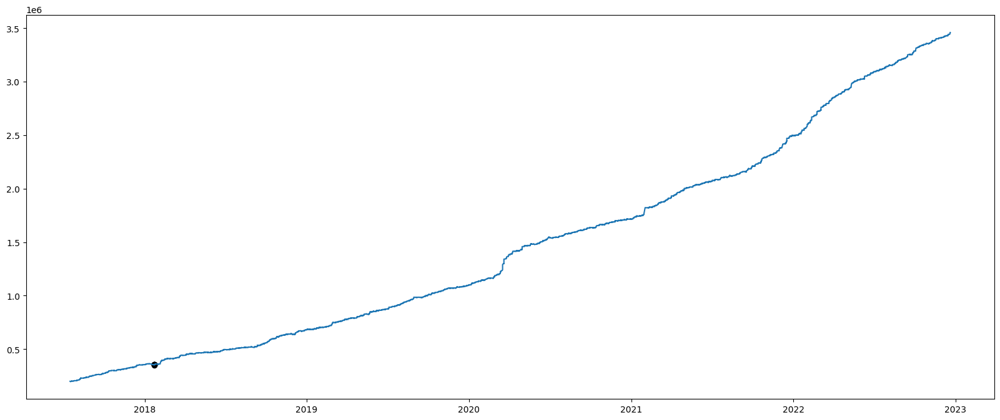

In [173]:

drawdown_figure = plt.figure(figsize=(20,8))
plt.plot(intraday_trade_log['Date'],intraday_trade_log['Equity'])
plt.scatter(drawdown_df['Date'],drawdown_df['Equity'],color='black')

C:\Users\pc\AppData\Local\Temp\ipykernel_8172\1109016795.py:8: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', 0)` for the same effect.

  sns.barplot(x='Month-Year', y='%Change', data=returns, estimator=np.median, ci=0)


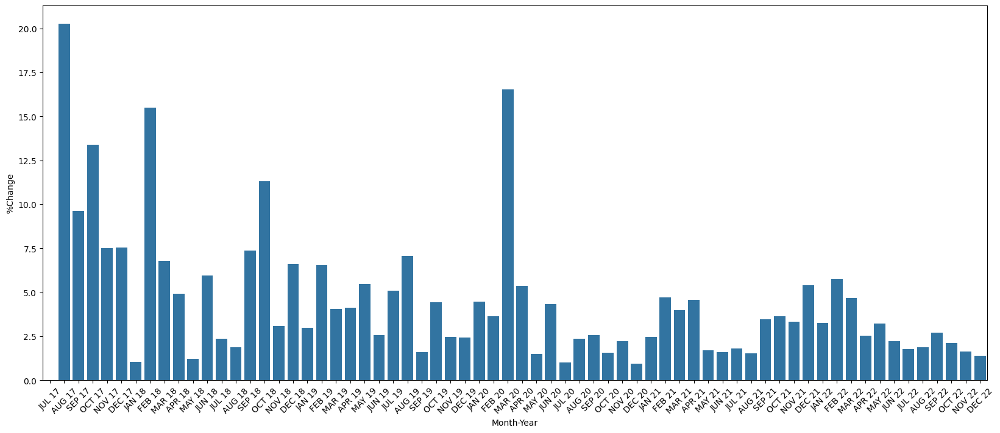

In [174]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

returns['Month-Year'] = returns.apply(lambda x: (str(x['Month']) + ' ' + str(x['Year'])[-2:]).upper(), axis=1)

plt.figure(figsize=(20, 8))
sns.barplot(x='Month-Year', y='%Change', data=returns, estimator=np.median, ci=0)
plt.xticks(rotation=45)  # Rotate x-axis labels by 45 degrees for better visibility
plt.show()



In [175]:
metrics.T


,0
Backtest Start Date,2017-07-17
Backtest End Date,2022-12-20
Number of Trades,7552
Number of Wins,2483
Number of Losses,5065
Average Profit,2032.24
Average Loss,-353.2
Maximum Profit Points,64200.0
Maximum Loss Points,-600.0
Median Trade,-300.0


In [176]:
broad_returns_image

Month,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec,Total
Year,,,,,,,,,,,,,
2017,nan,nan,nan,nan,nan,nan,nan,20.28,9.62,13.38,7.50,7.54,58.33
2018,1.05,15.50,6.78,4.92,1.23,5.95,2.37,1.86,7.38,11.30,3.08,6.62,68.04
2019,2.99,6.53,4.07,4.12,5.47,2.57,5.09,7.05,1.61,4.44,2.45,2.43,48.83
2020,4.46,3.62,16.52,5.35,1.51,4.32,1.01,2.36,2.57,1.56,2.23,0.93,46.45
2021,2.47,4.71,3.98,4.57,1.69,1.59,1.81,1.52,3.46,3.64,3.32,5.40,38.16
2022,3.25,5.75,4.68,2.54,3.23,2.23,1.76,1.87,2.70,2.10,1.62,1.38,33.11


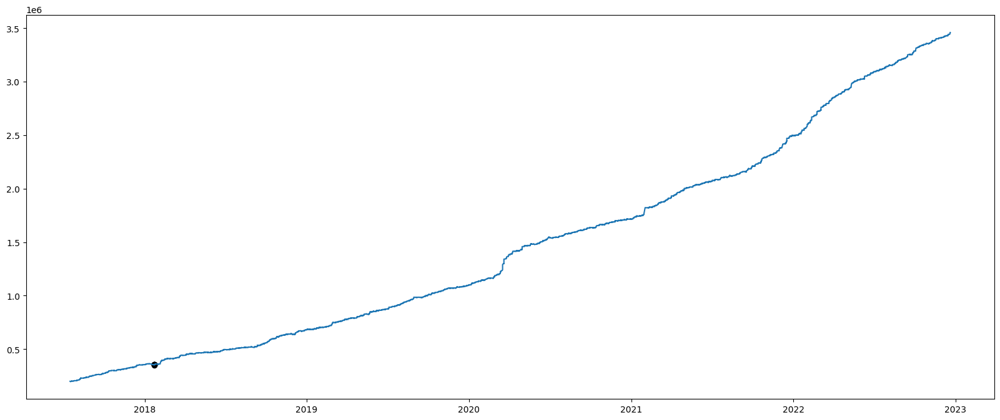

In [177]:
drawdown_figure
